In [ ]:
#Install Pandas (For CI Success) - Have to install Locally
%pip install pandas

In [ ]:
#Install Seaborn (For CI Success) - Have to install Locally
%pip install seaborn

In [ ]:
#Install Plotly (For CI Success) - Have to install Locally
%pip install plotly

In [1]:
#importing libraries and creating a data frame of the dataset
import pandas as pd
import numpy as np
import seaborn as sns
import plotly
# connected=True means it will download the latest version of plotly javascript library.
plotly.offline.init_notebook_mode(connected=True)
import plotly.graph_objs as go

import plotly.figure_factory as ff
import scipy.stats as stats

In [22]:
color = sns.color_palette()
sns.set(rc={'figure.figsize':(15,15)})

In [18]:
#Read Google Play Store CSV
df=pd.read_csv('../googleplaystore_clean.csv') 

In [19]:
#printing top rows
df.head()

,Unnamed: 0,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content_Rating,Genres,Last_Updated,Current_Ver,Android_Ver
0,0,Photo Editor & Candy Camera & Grid & ScrapBook,ART_AND_DESIGN,4.1,159,19000000.0,10000,Free,0.0,Everyone,Art & Design,2018-01-07,1.0.0,4.0.3 and up
1,1,Coloring book moana,ART_AND_DESIGN,3.9,967,14000000.0,500000,Free,0.0,Everyone,Art & Design,2018-01-15,2.0.0,4.0.3 and up
2,2,"U Launcher Lite – FREE Live Cool Themes, Hide ...",ART_AND_DESIGN,4.7,87510,8700000.0,5000000,Free,0.0,Everyone,Art & Design,2018-08-01,1.2.4,4.0.3 and up
3,3,Sketch - Draw & Paint,ART_AND_DESIGN,4.5,215644,25000000.0,50000000,Free,0.0,Teen,Art & Design,2018-06-08,1.0,4.2 and up
4,4,Pixel Draw - Number Art Coloring Book,ART_AND_DESIGN,4.3,967,2800000.0,100000,Free,0.0,Everyone,Art & Design,2018-06-20,1.1,4.4 and up


In [23]:
# Basic EDA
x = df['Rating'].dropna()
y = df['Size'].dropna()
z = df['Installs'][df.Installs!=0].dropna()
p = df['Reviews'][df.Reviews!=0].dropna()
t = df['Type'].dropna()

price = df['Price']

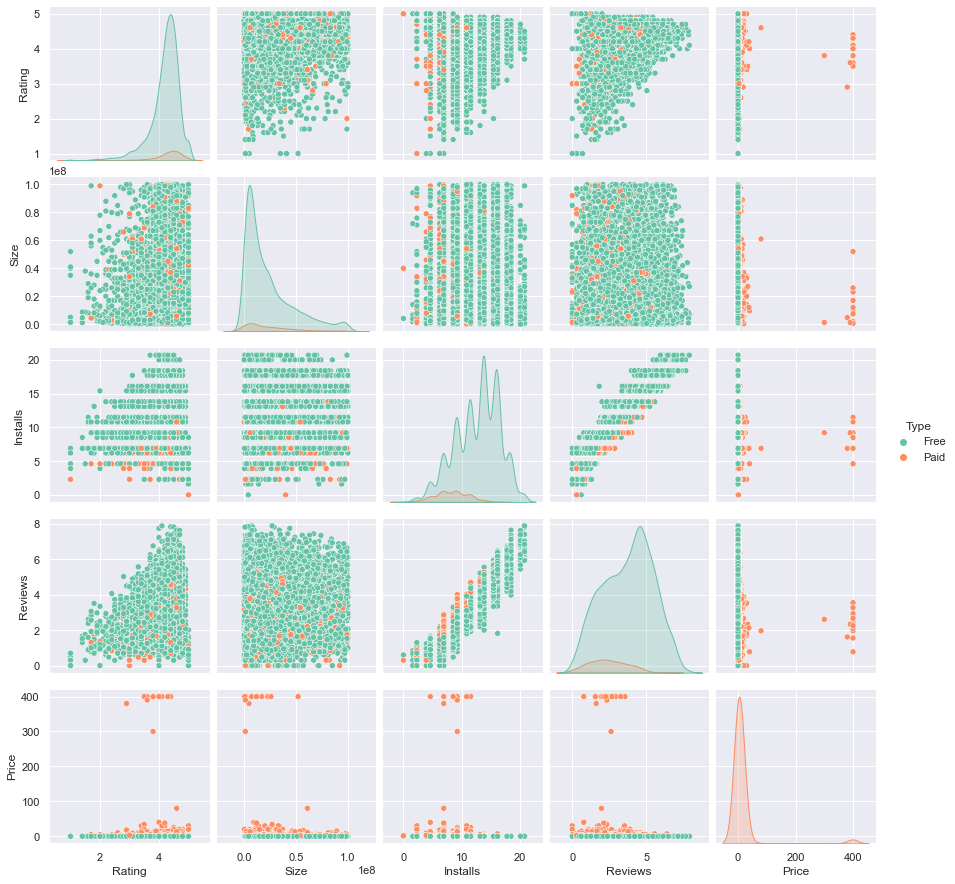

In [24]:
# This is the basic exploratory analysis to look for any evident patterns or relationships between the features. 

p = sns.pairplot(pd.DataFrame(list(zip(x, y, np.log(z), np.log10(p), t, price)), columns=['Rating','Size', 'Installs', 'Reviews', 'Type', 'Price']), hue='Type', palette="Set2")

In [25]:
value_counts_in_category = df['Category'].value_counts().sort_values(ascending=True)

data = [go.Pie(
    labels = value_counts_in_category.index,
     values = value_counts_in_category.values,
      hoverinfo = 'label+value')]

plotly.offline.iplot(data, filename='active_category')      

# Highest market prevelance is given to family and games
# Tools, Business and Medical apps also have a bright future ahead.

In [8]:
# Average Rating of Apps

data = [go.Histogram(
    x = df.Rating,
    xbins = {
        'start': 1,
         'size': 0.1,
          'end' :5
    })]

print('Average app rating = ', np.mean(df['Rating']))

plotly.offline.iplot(data, filename='overall_rating_distribution')    

Average app rating =  4.192469069392146


In [26]:
# App ratings across categories
# F One Way ANOVA Test
f_one_way_result = stats.f_oneway(
    df.loc[df.Category == 'BUSINESS']['Rating'].dropna(), 
    df.loc[df.Category == 'FAMILY']['Rating'].dropna(),
    df.loc[df.Category == 'GAME']['Rating'].dropna(),
    df.loc[df.Category == 'PERSONALIZATION']['Rating'].dropna(),
    df.loc[df.Category == 'LIFESTYLE']['Rating'].dropna(),
    df.loc[df.Category == 'FINANCE']['Rating'].dropna(),
    df.loc[df.Category == 'EDUCATION']['Rating'].dropna(),
    df.loc[df.Category == 'MEDICAL']['Rating'].dropna(),
    df.loc[df.Category == 'TOOLS']['Rating'].dropna(),
    df.loc[df.Category == 'PRODUCTIVITY']['Rating'].dropna())

print('P Value: ', f_one_way_result.pvalue)
print('Statistic: ', f_one_way_result.statistic)

P Value:  6.212621714464733e-29
Statistic:  17.505169822447975


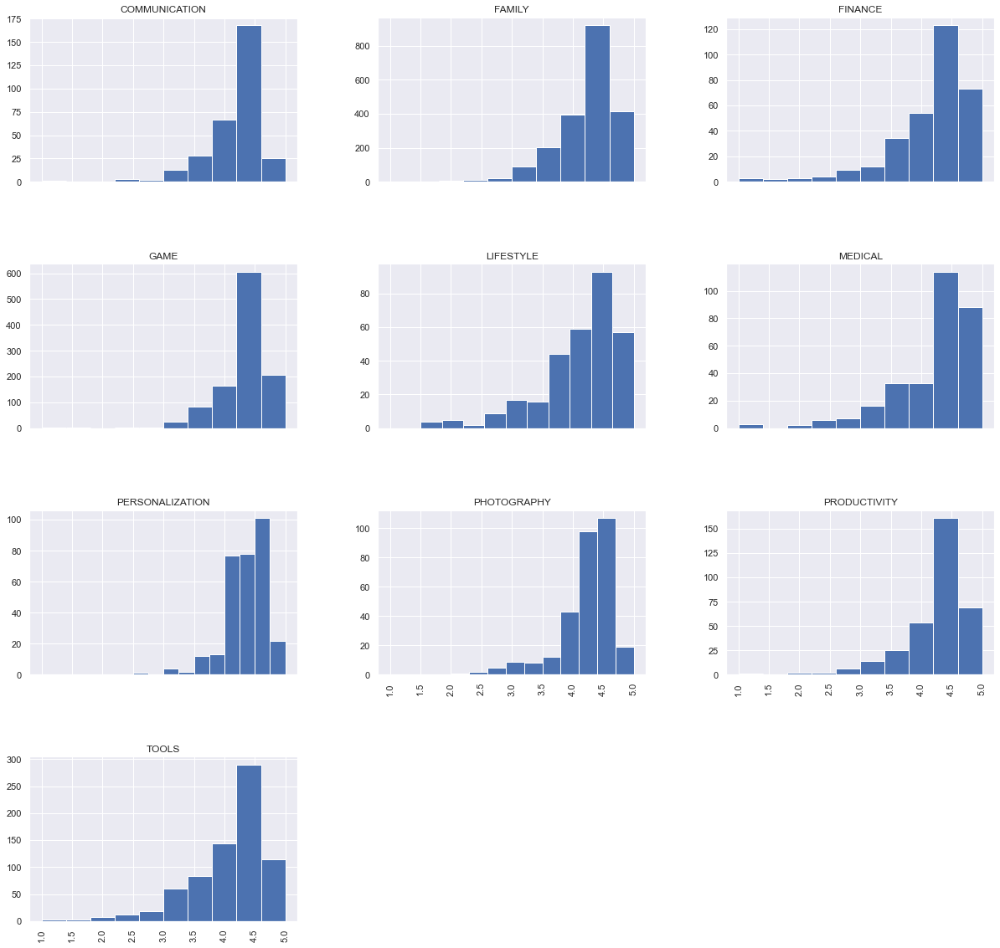

In [34]:
groups = df.groupby('Category').filter(lambda x: len(x) > 286).reset_index()

array = groups['Rating'].hist(by=groups['Category'], sharex=True, figsize=(20,20))

In [31]:
# Finding out which category performs the best
groups = df.groupby('Category').filter(lambda x: len(x) >= 170).reset_index()

#Calculating average rating of group
print('Average rating = ', np.nanmean(list(groups.Rating)))

layout = {'title' : 'App rating across major categories',
        'xaxis': {'tickangle':-40},
        'yaxis': {'title': 'Rating Across Categories'},
          'plot_bgcolor': 'rgb(250,250,250)',
          'shapes': [{
              'type' :'line',
              'x0': -.5,
              'y0': np.nanmean(list(groups.Rating)),
              'x1': 19,
              'y1': np.nanmean(list(groups.Rating)),
              'line': { 
                  'dash': 'dashdot'
                  }
            }]
        }
data = [{
    'y': df.loc[df.Category==category]['Rating'], 
    'type':'violin',
    'name' : category,
    'showlegend':False,
    } for i, category in enumerate(list(set(groups.Category)))]

plotly.offline.iplot({'data': data, 'layout': layout})    


Average rating =  4.1956982464993064


In [39]:
# How do the sizes of paid apps and free apps vary?
df_temp = df[df.Type == 'Paid']
df_temp = df_temp[df_temp.Size > 5]

data = [{'x' : df_temp['Rating'],'type':'scatter','y' : df_temp['Size'],'mode' : 'markers','text' : df['Size'],} for t in set(df_temp.Type)]

layout = {'title':"Rating vs Size", 'xaxis': {'title' : 'Rating'}, 'yaxis' : {'title' : 'Size (in MB)'},'plot_bgcolor': 'rgb(0,0,0)'}

plotly.offline.iplot({'data': data, 'layout': layout})

In [40]:
# How do the sizes of paid apps and free apps vary?
df_temp = df[df.Type == 'Free']
df_temp = df_temp[df_temp.Size > 5]

data = [{'x' : df_temp['Rating'],'type':'scatter','y' : df_temp['Size'],'mode' : 'markers','text' : df['Size'],} for t in set(df_temp.Type)]

layout = {'title':"Rating vs Size", 'xaxis': {'title' : 'Rating'}, 'yaxis' : {'title' : 'Size (in MB)'},'plot_bgcolor': 'rgb(0,0,0)'}

plotly.offline.iplot({'data': data, 'layout': layout})